In [1]:
import warnings
warnings.filterwarnings('ignore')

# Задание 0. Загрузка данных

In [2]:
import pandas as pd
data = pd.read_csv('https://raw.githubusercontent.com/agconti/kaggle-titanic/master/data/train.csv')
data.head() # посмотрим на данные

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.0,1,0,A/5 21171,7.2500,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.0,1,0,PC 17599,71.2833,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",female,26.0,0,0,STON/O2. 3101282,7.9250,NaN,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.0,1,0,113803,53.1000,C123,S
4,5,0,3,"Allen, Mr. William Henry",male,35.0,0,0,373450,8.0500,NaN,S


## Описание данных
| Variable | Definition                                 | Key                                            |
|----------|--------------------------------------------|------------------------------------------------|
| survival | Survival (выжил/нет)                                   | 0 = No, 1 = Yes                                |
| pclass   | Ticket class                               | 1 = 1st, 2 = 2nd, 3 = 3rd                      |
| sex      | Sex                                        |                                                |
| Age      | Age in years                               |                                                |
| sibsp    | # of siblings / spouses aboard the Titanic (число братьев/сестёр) |                                                |
| parch    | # of parents / children aboard the Titanic (число детей/родителей) |                                                |
| ticket   | Ticket number                              |                                                |
| fare     | Passenger fare (плата за проезд)                             |                                                |
| cabin    | Cabin number                               |                                                |
| embarked | Port of Embarkation                        | C = Cherbourg, Q = Queenstown, S = Southampton |

**Целевая переменная** - *Survived*

**Категориальные признаки** - *Pclass*, *Sex* (Бинарный), *Embarked*

**Числовые признаки** - *Fare*, *Age*

**Лишние колонки** - *PassengerId*, *Name*, *Ticket*, *Cabin*

In [3]:
X, y = data.drop(['PassengerId', 'Name', 'Ticket', 'Cabin', 'Survived'], 1), data['Survived']

# Закодируем One-Hot-Encoding'ом категориальные признаки
X = pd.get_dummies(X, columns=['Pclass', 'Sex', 'Embarked'])

In [4]:
X.shape, y.shape

((891, 12), (891,))

In [5]:
X.head(10)

,Age,SibSp,Parch,Fare,Pclass_1,Pclass_2,Pclass_3,Sex_female,Sex_male,Embarked_C,Embarked_Q,Embarked_S
0,22.0,1,0,7.2500,0,0,1,0,1,0,0,1
1,38.0,1,0,71.2833,1,0,0,1,0,1,0,0
2,26.0,0,0,7.9250,0,0,1,1,0,0,0,1
3,35.0,1,0,53.1000,1,0,0,1,0,0,0,1
4,35.0,0,0,8.0500,0,0,1,0,1,0,0,1
5,NaN,0,0,8.4583,0,0,1,0,1,0,1,0
6,54.0,0,0,51.8625,1,0,0,0,1,0,0,1
7,2.0,3,1,21.0750,0,0,1,0,1,0,0,1
8,27.0,0,2,11.1333,0,0,1,1,0,0,0,1
9,14.0,1,0,30.0708,0,1,0,1,0,1,0,0


In [6]:
X.fillna(X.mean(), inplace=True) # заменим пропущенные данные на соответсвующие средние. inplace=True означает, что переменная X_train автоматически обновится
X.head(10)

,Age,SibSp,Parch,Fare,Pclass_1,Pclass_2,Pclass_3,Sex_female,Sex_male,Embarked_C,Embarked_Q,Embarked_S
0,22.000000,1,0,7.2500,0,0,1,0,1,0,0,1
1,38.000000,1,0,71.2833,1,0,0,1,0,1,0,0
2,26.000000,0,0,7.9250,0,0,1,1,0,0,0,1
3,35.000000,1,0,53.1000,1,0,0,1,0,0,0,1
4,35.000000,0,0,8.0500,0,0,1,0,1,0,0,1
5,29.699118,0,0,8.4583,0,0,1,0,1,0,1,0
6,54.000000,0,0,51.8625,1,0,0,0,1,0,0,1
7,2.000000,3,1,21.0750,0,0,1,0,1,0,0,1
8,27.000000,0,2,11.1333,0,0,1,1,0,0,0,1
9,14.000000,1,0,30.0708,0,1,0,1,0,1,0,0


В итоге X представляет собой 891 объект с 12 признаками, y - одномерный вектор из 891 ответа

In [7]:
# разобьём на train/test для дальнейшего тестирования моделей
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.85) # 85% решили оставить на train, поскольку данных мало

Видим, что таблица содержит пустые значения. Заполним их средним

## Мотивация к использованию ансамблей
Основная мотивация - уменьшить разброс предсказаний за счёт усреднения результатов разных моделей

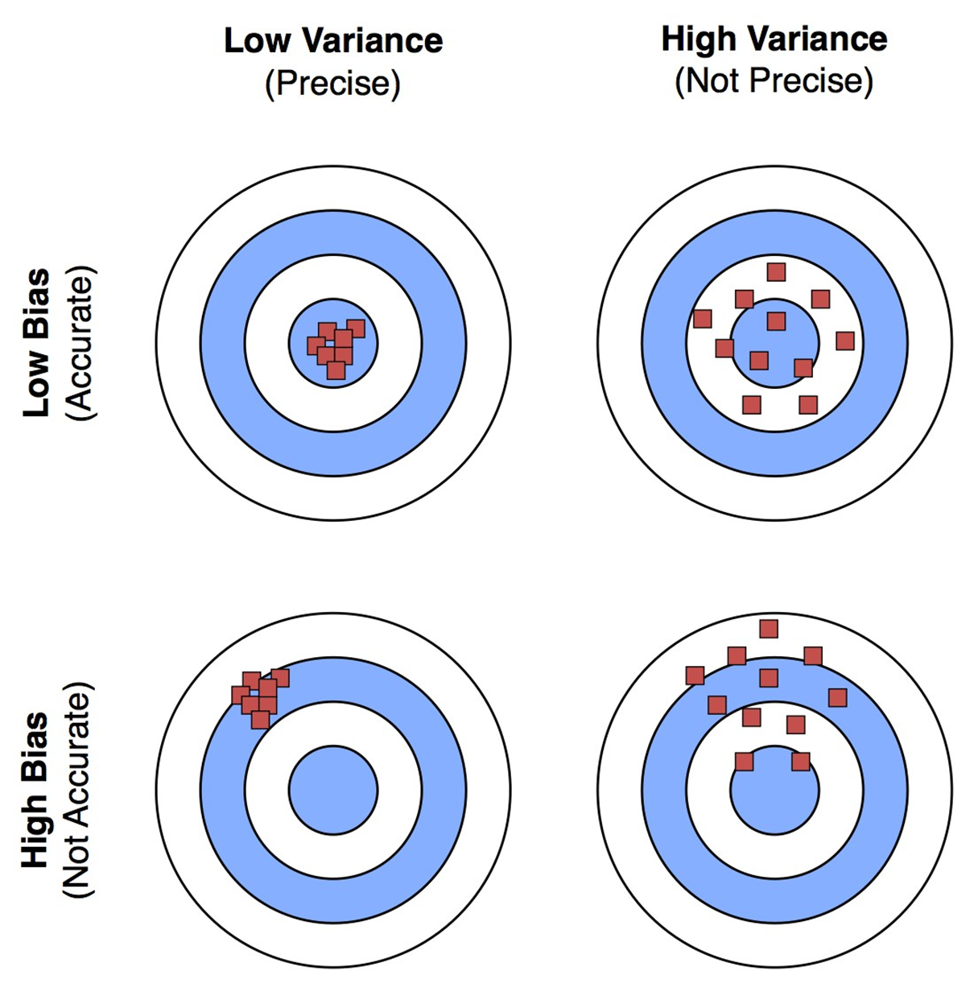

Ясно, что при усреднении результатов разных независимо-обученных моделей усреднённый результат (итоговое предсказание) будет менее разбросано и меньше смещено. Но как же можно усреднять результаты разных классификаторов? Существует несколько классических подходов

# Ансамбли
Идея всех ансамблей - объединить предсказания разных классификаторов с целью получить более устойчивое и лучшее предсказание

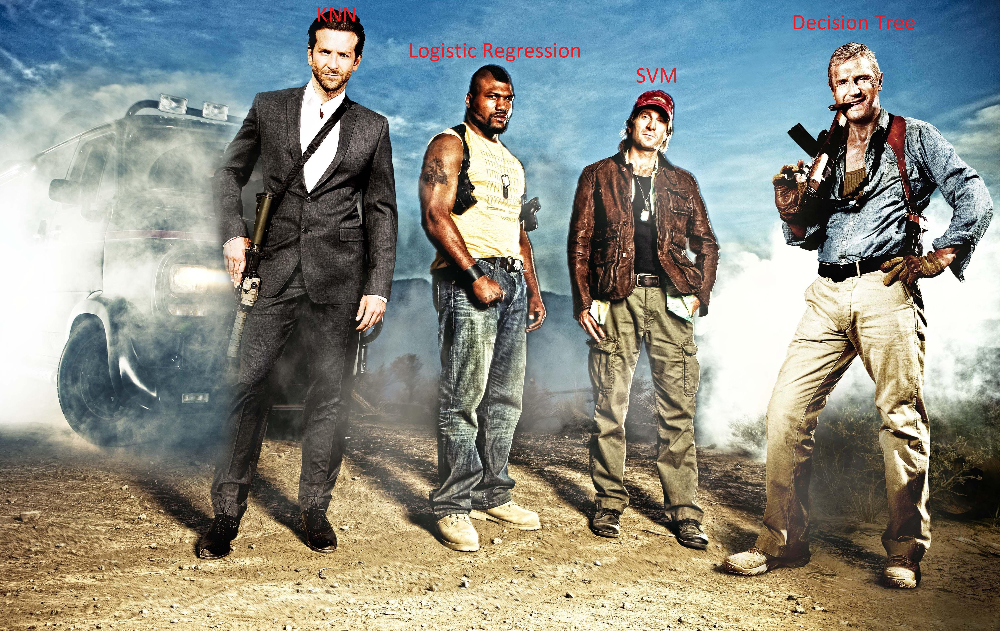

## 1. Бэггинг
Суть его заключается в обучении на разных подмножествах объектов и признаков и дальнейшем усреднении.

В sklearn есть готовый каркас бэггинга для [классификации](http://scikit-learn.org/stable/modules/generated/sklearn.ensemble.BaggingClassifier.html) и [регрессии](http://scikit-learn.org/stable/modules/generated/sklearn.ensemble.BaggingRegressor.html). Его основные параметры:

* **base_estimator** - базовый классификатор(регрессор), из которого будет построен ансмабль
* **n_estimators** - размер ансамбля
* **max_samples** - максимальное количество (доля) объектов, на которых будет обучаться каждый классификатор (регрессор)
* **max_features** - максимальное количество признаков, на которых будет обучаться каждый классификатор (регрессор)
* **bootstrap** - если True, то в обучающей выборке (сабсэмпле) для каждой модели ансамбля объекты могут повторяться
* **bootstrap_features** - аналогично для признаков

Найдём наилучшие параметры для базового классификатора

In [9]:
from sklearn.ensemble import BaggingClassifier
from sklearn.tree import DecisionTreeClassifier

base_estimator = DecisionTreeClassifier() # оптимальные параметры можно подобрать гридсёчем

from sklearn.model_selection import GridSearchCV
params_grid = { 
    'criterion': ['gini', 'entropy'],
    'max_depth': list(range(5, 10)),
    'max_features': [0.1, 0.2, 0.3, 0.5, 0.7, 0.9, 1.0],
    'min_samples_leaf': list(range(3, 20))
}
base_gs = GridSearchCV(base_estimator, params_grid, scoring='accuracy')
base_gs.fit(X_train, y_train)

base_estimator = base_gs.best_estimator_
base_gs.best_params_

//anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_search.py:813: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


{'criterion': 'entropy',
 'max_depth': 6,
 'max_features': 0.9,
 'min_samples_leaf': 3}

In [10]:
clf = base_gs.best_estimator_
y_pred = clf.predict(X_test)
from sklearn.metrics import accuracy_score
print('Accuracy (train): %.3f' % base_gs.best_score_)  # лучший scoring ("accuracy") на train'e. %.3f означает float до 3 знаков после запятой
print('Accuracy (test): %.3f' % accuracy_score(y_pred, y_test))

Accuracy (train): 0.830
Accuracy (test): 0.806


Подставим этот наилучший классификатор в ансамбль

In [10]:
params_grid = { # параметры ансамбля
    'n_estimators': [1, 5, 10, 30, 50],
    'max_samples': [0.1, 0.3, 0.5, 0.7, 1.0],
    'max_features': [0.1, 0.3, 0.5, 0.7, 1.0]
}
ensemble = BaggingClassifier(base_estimator)
ensemble_gs = GridSearchCV(ensemble, params_grid, scoring='accuracy')
ensemble_gs.fit(X_train, y_train)

ensemble_gs.best_params_

{'max_features': 0.7, 'max_samples': 0.5, 'n_estimators': 10}

In [11]:
clf = ensemble_gs.best_estimator_
y_pred = clf.predict(X_test)
from sklearn.metrics import accuracy_score
print('Accuracy (train): %.3f' % ensemble_gs.best_score_)  # лучший scoring ("accuracy") на train'e. %.3f означает float до 3 знаков после запятой
print('Accuracy (test): %.3f' % accuracy_score(y_pred, y_test))

Accuracy (train): 0.808
Accuracy (test): 0.851


Оказывается, в случае деревьев здесь не надо ничего нового придумывать и всё уже давно сделано за вас! [RandomForestClassifier](http://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html) и [RandomForetsRegressor](http://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestRegressor.html)

In [12]:
from sklearn.ensemble import RandomForestClassifier

best_params = dict(base_gs.best_params_, **ensemble_gs.best_params_) # объединим лучшие параметры с предыдущих стадий GridSearch
best_params = {key: value for key, value in best_params.items() if key in RandomForestClassifier().__dict__} # оставим только те параметры, которые есть в RandomForest
# по-хорошему, можно было бы запустить отдельный GridSearch. Но наша задача сейчас - убедиться, что он работает так же

clf = RandomForestClassifier(**best_params)
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)
from sklearn.metrics import accuracy_score
print('Accuracy (train): %.3f' % ensemble_gs.best_score_)  # лучший scoring ("accuracy") на train'e. %.3f означает float до 3 знаков после запятой
print('Accuracy (test): %.3f' % accuracy_score(y_pred, y_test))

Accuracy (train): 0.808
Accuracy (test): 0.858


В качестве дополнительного бонуса RandomForest позволяет оценивать важность признаков

In [13]:
list(zip(X_train.columns, clf.feature_importances_))

[('Age', 0.1467110720375726),
 ('SibSp', 0.05780529306120517),
 ('Parch', 0.014810484281505115),
 ('Fare', 0.19117399577460564),
 ('Pclass_1', 0.030095247517770058),
 ('Pclass_2', 0.010019067283523676),
 ('Pclass_3', 0.10653180191424069),
 ('Sex_female', 0.2558555306461258),
 ('Sex_male', 0.16857142130790956),
 ('Embarked_C', 0.0074738142505994965),
 ('Embarked_Q', 0.005551609163196625),
 ('Embarked_S', 0.005400662761745509)]

## 2. Голосование
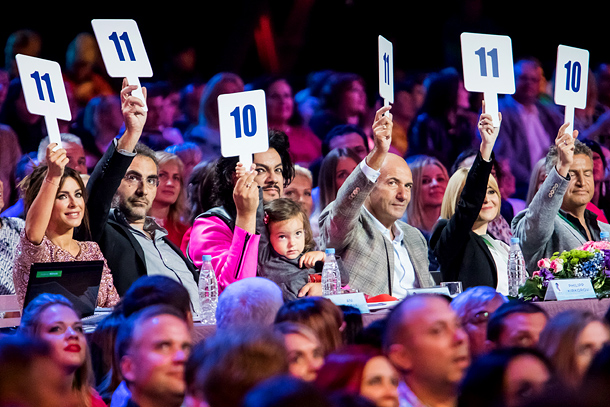

Суть этого ансамблирование несколько другая. Здесь вы используете уже обученные классификаторы (они должны быть достаточно сильными) и устраиваете среди них голосование (либо "hard" - по большинству голосов, либо "soft" - по сумме вероятностей). Здесь опять же всё уже реализовано за вас в классе [VotingClassifier](scikit-learn.org/stable/modules/generated/sklearn.ensemble.VotingClassifier.html). Прелесть ансамблей в том, что можно делать ансамбли над ансамблями

In [14]:
from sklearn.linear_model import LogisticRegressionCV
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import VotingClassifier
# можно погридсёчить параметры для каждой модели
clf1 = LogisticRegressionCV()
clf2 = SVC()
clf3 = RandomForestClassifier()
clf4 = KNeighborsClassifier()
clf = VotingClassifier([('lr', clf1), ('svc', clf2), ('rf', clf3), ('knn', clf4)], voting='hard', weights=[1.0, 1.0, 1.0, 0.1]) # weight - авторитет каждого классификатора
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)
'Accuracy (test): %.3f' % accuracy_score(y_pred, y_test)

c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


'Accuracy (test): 0.836'

## Резюме по ансамблям
**Плюсы**: 
* Возможность получать одновременно сложные и устойчивые к переобучению модели
* Возможность использовать уже обученные модели (причём не обязательно одного класса)
* Возможность получать модель с меньшей смещённостью и дисперсией (более устойчивый результат)
* Возможность воздерживаться от предсказаний некоторым моделям
* Возможностью обучать такие переобучаемые алгоритмы, как Decision Trees, на больших данных
* Дают дополнительный способ оценивать важность признаков (feature_importances_ в SkLearn)

**Минусы**:
* Возрастает сложность моделей
* Сложная интерпретация результата
* Требует большого количества данных
* Требует большего времени обучения
* В общем случае функционал невыпуклый

# Бустинг
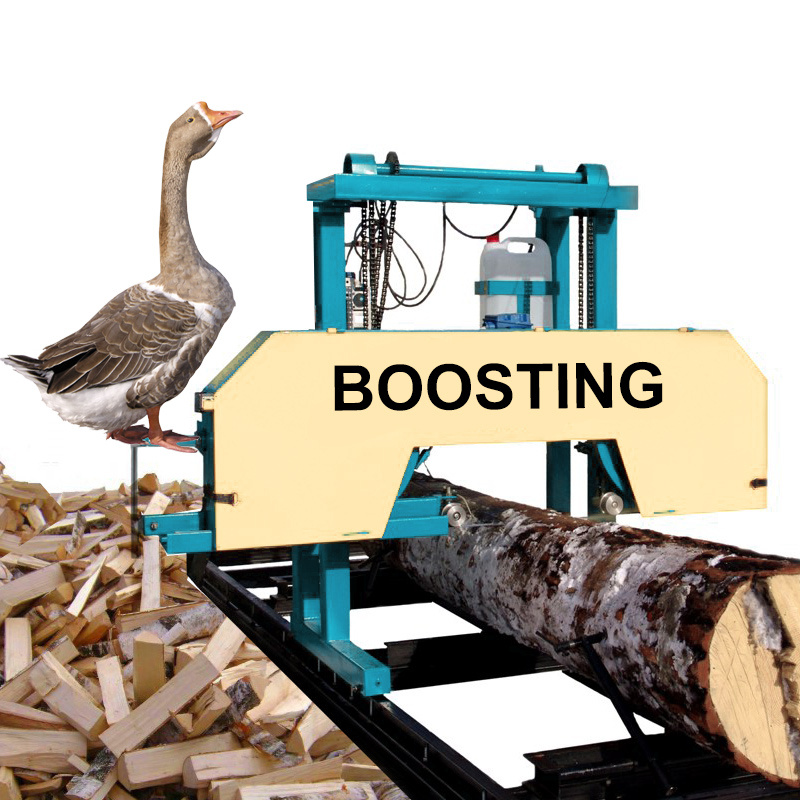

Бустинг - более сильный подход к ансамблированию. Если раньше модели ансамбля обучались независимо друг от друга (что отчасти хорошо), то в бустинге предлагается каждую следующую модель обучать на ошибках предыдущих. Здесь тоже существует несколько подходов к ансамблированию

## 1. AdaBoost
Суть адаптивного бустинга (AdaBoost) - перевзвешивать ошибочные объекты, чтобы при последовательном добавлении следующей модели она больше внимания уделяла этим объектам и меньше остальным

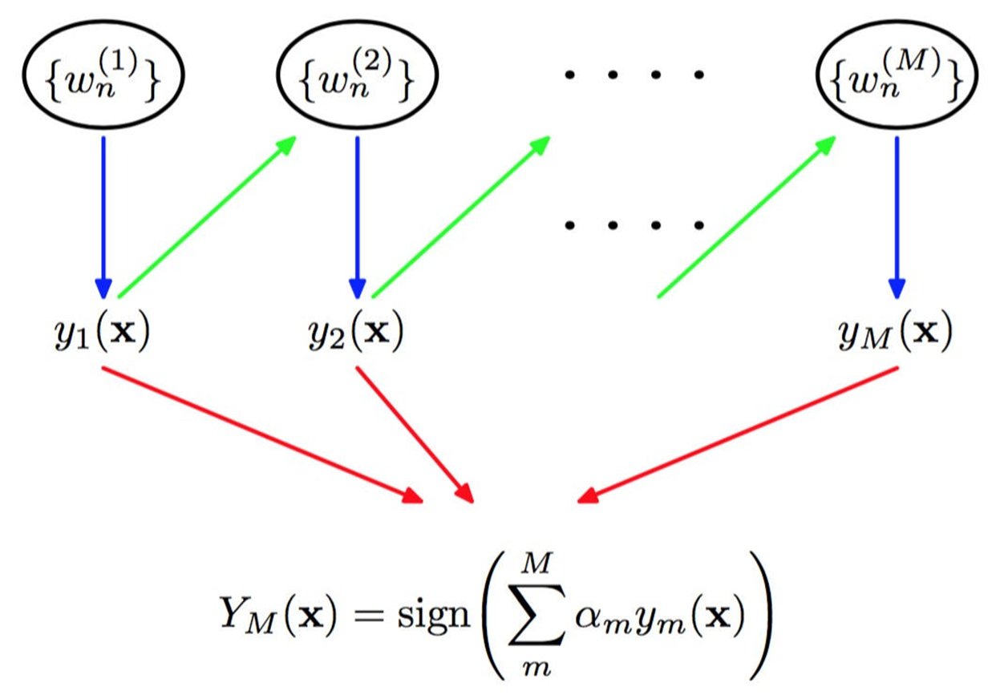

In [17]:
from sklearn.ensemble import AdaBoostClassifier

clf = AdaBoostClassifier() # можно задать свой base_estimator в качестве первого параметра

params_grid = {
    'n_estimators': [1, 10, 30, 50], # размер ансамбля 
    'learning_rate': [0.1, 0.01, 0.001] # скорость обновления весов
}
gs = GridSearchCV(clf, params_grid)
gs.fit(X_train, y_train)
clf = gs.best_estimator_
y_pred = clf.predict(X_test)
"Accuracy (test): %.3f" % accuracy_score(y_pred, y_test)

'Accuracy (test): 0.836'

## 2. GradientBoosting
Каждый следующий классификатор ансамбля обучать не на исходной функции потерь, а на невязке.

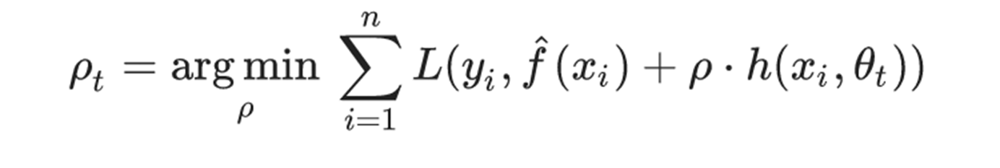

На этом рисунке $h$ - предсказанная новым классификатором поправка к основным предсказаниям $\hat{f}(x_i)$, $\rho$ - величина градиантного шага (иногда называют learning rate)

В теории добавление каждой такой новой поправки эквивалентно градиентному шагу в оптимизации основного функционала. Поэтому такой бустинг и называется градиентным

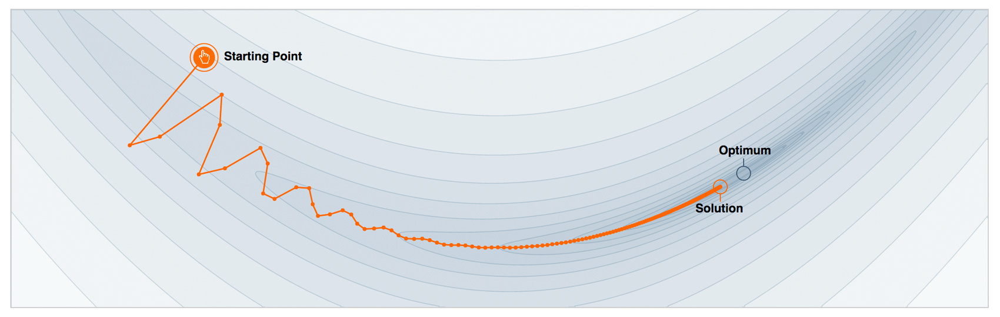

In [18]:
from sklearn.ensemble import GradientBoostingClassifier

clf = GradientBoostingClassifier() # можно задать свой base_estimator в качестве первого параметра

params_grid = {
    'n_estimators': [1, 10, 30, 50], # размер ансамбля 
    'learning_rate': [0.1, 0.01, 0.001] # величина градиентного шага (скорость обучения) = величина поправки от каждого следующего классификатора
}
gs = GridSearchCV(clf, params_grid)
gs.fit(X_train, y_train)
clf = gs.best_estimator_
y_pred = clf.predict(X_test)
"Accuracy (test): %.3f" % accuracy_score(y_pred, y_test)

'Accuracy (test): 0.813'

## 3. Резюме
Бустинг - один из топовых подходов к решению задач классификации и регрессии (supervised learning), активно использующийся в Яндексе и других крупных корпорациях, а также по сей день активно используемых на Kaggle и хакатонах. Однако, с ним нужно быть осторожным, поскольку при неправильном подборе параметров (как правило, при очень большом значении **n_estimators**) бустинг очень склонен к переобучению.

**Плюсы:**
* Хорошая аппроксимационная способность. Заведомо лучшая, чем при использовании независимых ансамблей
* При правильном использовании даёт наилучшее качество

**Минусы:**
* Наибольшая склонность к переобучению
* Интерпретируемость ещё хуже
* Необходимость обучать каждый классификатор не под целевую функцию исходной задачи, а под переменную, которая на каждом шаге своя

# * Более продвинутые алгоритмы бустинга

## 1. XGBoost

**Основные параметры**

| Параметр          | Тип                | Описание                                                                                                                                     | Диапазон значений      |
|-------------------|--------------------|----------------------------------------------------------------------------------------------------------------------------------------------|------------------------|
| **max_depth**         | int                | Максимальная глубина каждого дерева                                                                                                          | 3-10                   |
| **learning_rate**     | float              | Шаг градиентного бустинга                                                                                                                    | 0.01-0.2               |
| **n_estimators**      | int                | Размер ансамбля                                                                                                                              | 100-1000               |
| **objective**         | string or callable | Оптмизируемый функционал. В отличие от метрики качества, должен быть всюду дифференцируем                                                    |                        |
| **booster**           | string             | Какой бустинг использовать                                                                                                                   | [gbtree,gblinear,dart] |
| **nthread**           | int                | Количество потоков, в котором будет обучаться XGBoost                                                                                        |                        |
| **n_jobs**            | int                | -//-                                                                                                                                         |                        |
| **gamma**             | float              |  Минимальный прирост качества функционала ошибки, при котором лист дерева будет поделён на поддеревья. Минимальный критерий ветвления дерева |                        |
| **min_child_weight**  | float              | Минимальная сумма весов в листе дерева для того, чтобы его не выкинуть                                                                       |                        |
| **max_delta_step**    | int                | Максимальный шаг, с которым можно обновлять веса деревьев                                                                                    |                        |
| **subsample**         | float              | На какой случайной доли обучающей выборки будет обучаться каждое дерево                                                                      |                        |
| **colsample_bytree**  | float              | На какой случайной доли признаков будет обучаться каждое дерево                                                                              | [0.5-1]                |
| **colsample_bylevel** | float              | Какая доля признаков пойдёт в каждое поддерево                                                                                               |                        |
| **reg_alpha**         | float              | L1-регуляризация для листьев дерева                                                                                                          |                        |
| **reg_lambda**        | float              | L2-регуляризация для листьев дерева                                                                                                          |                        |
| **scale_pos_weight**  | float              | Какой вес придадим второму классу объектов (1) по сравнению с первым (0). Используется при сильно несбалансированной выборке                 |                        |
| **base_score**        | float              |  До какого скора объекты будут отнесену к первому классу (0) и с какого ко второму (1). По умолчанию 0.5. Обычно не тюнят                    |                        |
| **seed**              | int                | Начальная точка для генератора случайных чисел                                                                                               |                        |
| **random_state**      | int                | -//-                                                                                                                                         |                        |
| **missing**           | float (optional)   | Что принимать за пропущенные значения. По умолчанию np.nan.                                                                                  |                        |
| **silent**            | boolean            | Если True, то выводить всю информацию об обучении                                                                                            |                        |

In [20]:
from xgboost import XGBClassifier
from sklearn.grid_search import GridSearchCV
from sklearn.metrics import accuracy_score
clf = XGBClassifier()

params_grid = {
    'n_estimators': [1, 10, 30, 50], # размер ансамбля 
    'learning_rate': [0.1, 0.01, 0.001] # величина градиентного шага (скорость обучения) = величина поправки от каждого следующего классификатора
}

gs = GridSearchCV(clf, params_grid)
gs.fit(X_train, y_train)
clf = gs.best_estimator_

y_pred = clf.predict(X_test)
"Accuracy (test): %.3f" % accuracy_score(y_pred, y_test)

c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is depreca

c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread pa

c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread pa

'Accuracy (test): 0.851'

## 2. CatBoost
**Плюсы:**
* Возможность работать с категориальными признаками напрямую
* Встроенный пакет визуализации обучения

**Основные параметры:**
* iterations - размер ансамбля
* learning_rate - скорость обучения
* use_best_model - если True, то вернётся ансамбль с таким количеством деревьев, при котором eval_metric максимальна
* eval_metric - см. выше
* depth - максимальная глубина каждого дерева. аналог max_depth
* l2_leaf_reg - регуляризация на веса в листьях. аналог reg_lambda в XGBoost
* rsm - аналог max_features в RandomForest и BaggingClassifier - максимальная доля признаков, используемых каждым деревом

Подробнее про параметры можно почитать [здесь](https://tech.yandex.com/catboost/doc/dg/concepts/parameter-tuning-docpage/)

In [21]:
from catboost import CatBoostClassifier

clf = CatBoostClassifier()

# 
params_grid = {
    'iterations': [1, 10, 30, 50], # размер ансамбля
    'learning_rate': [0.1, 0.01, 0.001] # величина градиентного шага (скорость обучения) = величина поправки от каждого следующего классификатора
}
gs = GridSearchCV(clf, params_grid)
gs.fit(X_train, y_train)
clf = gs.best_estimator_

y_pred = clf.predict(X_test)
"Accuracy (test): %.3f" % accuracy_score(y_pred, y_test)

0:	learn: 0.6419011	total: 78.3ms	remaining: 0us
0:	learn: 0.6393788	total: 18.6ms	remaining: 0us
0:	learn: 0.6593773	total: 10ms	remaining: 0us
0:	learn: 0.6874883	total: 22.1ms	remaining: 0us
0:	learn: 0.6863585	total: 34.1ms	remaining: 0us
0:	learn: 0.6876593	total: 21.4ms	remaining: 0us
0:	learn: 0.6925727	total: 19.3ms	remaining: 0us
0:	learn: 0.6925480	total: 29.6ms	remaining: 0us
0:	learn: 0.6927600	total: 14.5ms	remaining: 0us
0:	learn: 0.6398350	total: 44.5ms	remaining: 401ms
1:	learn: 0.5983448	total: 66.4ms	remaining: 266ms
2:	learn: 0.5695539	total: 87.7ms	remaining: 205ms
3:	learn: 0.5406806	total: 116ms	remaining: 175ms
4:	learn: 0.5192458	total: 193ms	remaining: 193ms
5:	learn: 0.5031746	total: 275ms	remaining: 183ms
6:	learn: 0.4920055	total: 297ms	remaining: 127ms
7:	learn: 0.4866661	total: 315ms	remaining: 78.7ms
8:	learn: 0.4790730	total: 332ms	remaining: 36.9ms
9:	learn: 0.4723644	total: 358ms	remaining: 0us
0:	learn: 0.6369921	total: 39.3ms	remaining: 354ms
1:	lear

5:	learn: 0.5113779	total: 154ms	remaining: 617ms
6:	learn: 0.4868345	total: 188ms	remaining: 619ms
7:	learn: 0.4671225	total: 219ms	remaining: 601ms
8:	learn: 0.4580567	total: 242ms	remaining: 566ms
9:	learn: 0.4406218	total: 277ms	remaining: 555ms
10:	learn: 0.4354940	total: 293ms	remaining: 507ms
11:	learn: 0.4276466	total: 321ms	remaining: 481ms
12:	learn: 0.4179622	total: 349ms	remaining: 456ms
13:	learn: 0.4153055	total: 365ms	remaining: 417ms
14:	learn: 0.4080575	total: 395ms	remaining: 395ms
15:	learn: 0.4023163	total: 425ms	remaining: 372ms
16:	learn: 0.3981964	total: 456ms	remaining: 348ms
17:	learn: 0.3934786	total: 488ms	remaining: 325ms
18:	learn: 0.3881610	total: 515ms	remaining: 298ms
19:	learn: 0.3821385	total: 548ms	remaining: 274ms
20:	learn: 0.3769296	total: 629ms	remaining: 269ms
21:	learn: 0.3733277	total: 696ms	remaining: 253ms
22:	learn: 0.3719130	total: 742ms	remaining: 226ms
23:	learn: 0.3686087	total: 774ms	remaining: 193ms
24:	learn: 0.3655090	total: 800ms	re

23:	learn: 0.6787586	total: 1.06s	remaining: 266ms
24:	learn: 0.6781525	total: 1.11s	remaining: 222ms
25:	learn: 0.6774562	total: 1.18s	remaining: 181ms
26:	learn: 0.6768973	total: 1.2s	remaining: 134ms
27:	learn: 0.6763390	total: 1.26s	remaining: 90.4ms
28:	learn: 0.6759142	total: 1.29s	remaining: 44.4ms
29:	learn: 0.6753673	total: 1.32s	remaining: 0us
0:	learn: 0.6927372	total: 16.3ms	remaining: 472ms
1:	learn: 0.6921675	total: 49.9ms	remaining: 698ms
2:	learn: 0.6916188	total: 76.3ms	remaining: 686ms
3:	learn: 0.6910808	total: 114ms	remaining: 744ms
4:	learn: 0.6905517	total: 147ms	remaining: 735ms
5:	learn: 0.6901981	total: 159ms	remaining: 635ms
6:	learn: 0.6896199	total: 195ms	remaining: 640ms
7:	learn: 0.6890793	total: 248ms	remaining: 682ms
8:	learn: 0.6887281	total: 261ms	remaining: 609ms
9:	learn: 0.6880453	total: 335ms	remaining: 671ms
10:	learn: 0.6873837	total: 374ms	remaining: 646ms
11:	learn: 0.6866911	total: 431ms	remaining: 646ms
12:	learn: 0.6862030	total: 448ms	remai

28:	learn: 0.3584071	total: 936ms	remaining: 677ms
29:	learn: 0.3565353	total: 968ms	remaining: 645ms
30:	learn: 0.3538122	total: 999ms	remaining: 613ms
31:	learn: 0.3503268	total: 1.03s	remaining: 580ms
32:	learn: 0.3464422	total: 1.06s	remaining: 546ms
33:	learn: 0.3448724	total: 1.09s	remaining: 513ms
34:	learn: 0.3418070	total: 1.12s	remaining: 481ms
35:	learn: 0.3400261	total: 1.15s	remaining: 448ms
36:	learn: 0.3371564	total: 1.18s	remaining: 415ms
37:	learn: 0.3366538	total: 1.2s	remaining: 380ms
38:	learn: 0.3343405	total: 1.23s	remaining: 348ms
39:	learn: 0.3342219	total: 1.25s	remaining: 312ms
40:	learn: 0.3319869	total: 1.28s	remaining: 280ms
41:	learn: 0.3316865	total: 1.3s	remaining: 248ms
42:	learn: 0.3286603	total: 1.33s	remaining: 216ms
43:	learn: 0.3251376	total: 1.36s	remaining: 185ms
44:	learn: 0.3235123	total: 1.38s	remaining: 154ms
45:	learn: 0.3228701	total: 1.42s	remaining: 123ms
46:	learn: 0.3220223	total: 1.45s	remaining: 92.4ms
47:	learn: 0.3200362	total: 1.48

40:	learn: 0.5408179	total: 1.54s	remaining: 339ms
41:	learn: 0.5382751	total: 1.59s	remaining: 303ms
42:	learn: 0.5358547	total: 1.62s	remaining: 264ms
43:	learn: 0.5343688	total: 1.63s	remaining: 223ms
44:	learn: 0.5314422	total: 1.66s	remaining: 184ms
45:	learn: 0.5279648	total: 1.68s	remaining: 146ms
46:	learn: 0.5268105	total: 1.69s	remaining: 108ms
47:	learn: 0.5247878	total: 1.71s	remaining: 71.1ms
48:	learn: 0.5236862	total: 1.72s	remaining: 35ms
49:	learn: 0.5208808	total: 1.78s	remaining: 0us
0:	learn: 0.6925360	total: 43.4ms	remaining: 2.13s
1:	learn: 0.6919913	total: 60.7ms	remaining: 1.46s
2:	learn: 0.6914166	total: 84.3ms	remaining: 1.32s
3:	learn: 0.6907884	total: 112ms	remaining: 1.29s
4:	learn: 0.6902912	total: 133ms	remaining: 1.2s
5:	learn: 0.6898534	total: 153ms	remaining: 1.12s
6:	learn: 0.6892481	total: 178ms	remaining: 1.09s
7:	learn: 0.6886827	total: 206ms	remaining: 1.08s
8:	learn: 0.6882095	total: 222ms	remaining: 1.01s
9:	learn: 0.6875891	total: 250ms	remaini

4:	learn: 0.5109584	total: 137ms	remaining: 1.23s
5:	learn: 0.4949616	total: 177ms	remaining: 1.3s
6:	learn: 0.4830248	total: 206ms	remaining: 1.26s
7:	learn: 0.4699659	total: 232ms	remaining: 1.22s
8:	learn: 0.4566856	total: 262ms	remaining: 1.19s
9:	learn: 0.4446130	total: 295ms	remaining: 1.18s
10:	learn: 0.4344303	total: 337ms	remaining: 1.2s
11:	learn: 0.4253288	total: 378ms	remaining: 1.2s
12:	learn: 0.4203555	total: 405ms	remaining: 1.15s
13:	learn: 0.4122675	total: 437ms	remaining: 1.12s
14:	learn: 0.4061887	total: 500ms	remaining: 1.17s
15:	learn: 0.4027128	total: 533ms	remaining: 1.13s
16:	learn: 0.4000229	total: 574ms	remaining: 1.11s
17:	learn: 0.3990898	total: 594ms	remaining: 1.05s
18:	learn: 0.3968920	total: 639ms	remaining: 1.04s
19:	learn: 0.3956629	total: 668ms	remaining: 1s
20:	learn: 0.3945366	total: 717ms	remaining: 990ms
21:	learn: 0.3925522	total: 787ms	remaining: 1s
22:	learn: 0.3899394	total: 828ms	remaining: 972ms
23:	learn: 0.3888308	total: 853ms	remaining: 9

'Accuracy (test): 0.866'

# ** Продвинутый тюнинг параметров

## XGBoost

## Шаг 1: Зафиксируем learning_rate и параметры дерева и подберём n_estimators

Параметры:

* **max_depth**. Как указанов в таблице выше, обычно варьируется в интервале от 3 до 10 (но от задачи к задаче значения могут меняться). В качестве начального значения обычно используют 5
* **min_child_weight**. Если выборка сильно несбалансирована, то лучше выбрать значение "1". Иначе лучше выбрать значение "2" и зафиксировать
* **gamma**. Обычно выставляют значение в интервале от 0 до 0.2 и фиксируют. В дальнейшем этот параметр всегда можно затюнить отдельно
* **subsample, colsample_bytree**. Выставим 0.8 и зафиксируем. Можно также проварьировать в интервале 0.5-0.9.
* **scale_pos_weight**. Выставляется в зафисимости от соотношения классов в выборке и фиксируется

In [22]:
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV

ones_ratio = y_train[y_train == 1].shape[0] * 1.0 / y_train[y_train == 0].shape[0] # посчитаем соотношение между классами

param_grid = {
    # параметры ансамбля
    'n_estimators': [10, 30, 50, 100, 200, 400, 600, 1000],
    'learning_rate': [0.1],
    
    # параметры дерева
    'max_depth': [5],
    'min_child_weight': [2],
    'gamma': [0.1],
    'subsample': [0.8],
    'colsample_bytree': [0.8],
    'scale_pos_weight': [ones_ratio],
    
    # параметры регуляризации
    'reg_alpha': [0.0],
    'reg_lambda': [1.0]
}

cv = KFold(n_splits=4, shuffle=True)

clf = XGBClassifier()
gs = GridSearchCV(clf, param_grid, scoring='roc_auc', cv=cv, verbose=5)

gs.fit(X_train, y_train)
best_params = gs.best_estimator_.get_params()
print('Best score (AUC): ', gs.best_score_)
print('Best params: ')
best_params

Fitting 4 folds for each of 8 candidates, totalling 32 fits
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=10, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 
[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=10, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.860340909091, total=   0.0s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=10, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 
[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=10, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.835675484176, total=   0.0s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estima

c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
c:\users\artem\

[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=30, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.847599039616, total=   0.0s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=50, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 
[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=50, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.861022727273, total=   0.0s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=50, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 
[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=50, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=

c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version 

[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=50, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.854741896759, total=   0.0s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=100, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 
[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=100, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.868011363636, total=   0.0s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=100, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=100, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.864726027397, total=   0.0s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=100, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 
[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=100, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.843, total=   0.0s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=100, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 
[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=100, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1,

c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=200, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.870738636364, total=   0.1s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=200, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 
[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=200, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.867205951819, total=   0.1s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=200, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=200, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.8419375, total=   0.1s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=200, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 
[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=200, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.859783913565, total=   0.1s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=400, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=400, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.868920454545, total=   0.2s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=400, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=400, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.859293811998, total=   0.2s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=400, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=400, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.8423125, total=   0.2s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=400, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=400, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.854981992797, total=   0.2s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=600, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=600, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.864261363636, total=   0.3s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=600, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=600, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.85374350496, total=   0.3s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=600, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=600, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.8483125, total=   0.3s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=600, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=600, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.850180072029, total=   0.3s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=1000, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=1000, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.858693181818, total=   0.6s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=1000, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=1000, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.853507321682, total=   0.9s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=1000, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=1000, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.8458125, total=   0.7s
[CV] reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=1000, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1 


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.0, colsample_bytree=0.8, scale_pos_weight=0.610638297872, learning_rate=0.1, min_child_weight=2, n_estimators=1000, subsample=0.8, reg_lambda=1.0, max_depth=5, gamma=0.1, score=0.847298919568, total=   0.7s


[Parallel(n_jobs=1)]: Done  32 out of  32 | elapsed:    8.1s finished
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


('Best score (AUC): ', 0.859930796521366)
Best params: 


{'base_score': 0.5,
 'booster': 'gbtree',
 'colsample_bylevel': 1,
 'colsample_bytree': 0.8,
 'gamma': 0.1,
 'learning_rate': 0.1,
 'max_delta_step': 0,
 'max_depth': 5,
 'min_child_weight': 2,
 'missing': None,
 'n_estimators': 200,
 'n_jobs': 1,
 'nthread': 1,
 'objective': 'binary:logistic',
 'random_state': 0,
 'reg_alpha': 0.0,
 'reg_lambda': 1.0,
 'scale_pos_weight': 0.6106382978723405,
 'seed': 0,
 'silent': True,
 'subsample': 0.8}

## Шаг 2. Подбираем параметры дерева
* **max_depth** - будем варьировать от 3 до 10 с шагом 2
* **min_child_weight** - от 1 до 6 с шагом 2

In [23]:
param_grid = {
    'max_depth': range(3, 10, 2),
    'min_child_weight': range(1, 6, 2)
}

clf = XGBClassifier(**best_params) # в качестве отправной точки возьмём модель с наилучшими параметрами предыдущего шага

gs = GridSearchCV(clf, param_grid, scoring='roc_auc', cv=cv, verbose=5)

gs.fit(X_train, y_train)
best_params = gs.best_estimator_.get_params()
print('Best score (AUC): ', gs.best_score_)
print('Best params: ')
best_params

Fitting 4 folds for each of 12 candidates, totalling 48 fits
[CV] max_depth=3, min_child_weight=1 .................................
[CV]  max_depth=3, min_child_weight=1, score=0.84118852459, total=   0.0s
[CV] max_depth=3, min_child_weight=1 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklear

[CV]  max_depth=3, min_child_weight=1, score=0.873354123354, total=   0.0s
[CV] max_depth=3, min_child_weight=1 .................................
[CV]  max_depth=3, min_child_weight=1, score=0.868719806763, total=   0.0s
[CV] max_depth=3, min_child_weight=1 .................................


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.2s remaining:    0.0s
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.3s remaining:    0.0s
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=3, min_child_weight=1, score=0.884852801519, total=   0.1s
[CV] max_depth=3, min_child_weight=3 .................................
[CV]  max_depth=3, min_child_weight=3, score=0.835462873674, total=   0.0s
[CV] max_depth=3, min_child_weight=3 .................................


[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.5s remaining:    0.0s
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=3, min_child_weight=3, score=0.861515361515, total=   0.0s
[CV] max_depth=3, min_child_weight=3 .................................
[CV]  max_depth=3, min_child_weight=3, score=0.870712560386, total=   0.0s
[CV] max_depth=3, min_child_weight=3 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=3, min_child_weight=3, score=0.894527540361, total=   0.0s
[CV] max_depth=3, min_child_weight=5 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=3, min_child_weight=5, score=0.839139344262, total=   0.1s
[CV] max_depth=3, min_child_weight=5 .................................
[CV]  max_depth=3, min_child_weight=5, score=0.86267036267, total=   0.1s
[CV] max_depth=3, min_child_weight=5 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=3, min_child_weight=5, score=0.869746376812, total=   0.0s
[CV] max_depth=3, min_child_weight=5 .................................
[CV]  max_depth=3, min_child_weight=5, score=0.906042260209, total=   0.0s
[CV] max_depth=5, min_child_weight=1 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=5, min_child_weight=1, score=0.842755544841, total=   0.1s
[CV] max_depth=5, min_child_weight=1 .................................
[CV]  max_depth=5, min_child_weight=1, score=0.872314622315, total=   0.1s
[CV] max_depth=5, min_child_weight=1 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=5, min_child_weight=1, score=0.852596618357, total=   0.0s
[CV] max_depth=5, min_child_weight=1 .................................
[CV]  max_depth=5, min_child_weight=1, score=0.878442545109, total=   0.0s
[CV] max_depth=5, min_child_weight=3 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=5, min_child_weight=3, score=0.845889585342, total=   0.0s
[CV] max_depth=5, min_child_weight=3 .................................
[CV]  max_depth=5, min_child_weight=3, score=0.866250866251, total=   0.0s
[CV] max_depth=5, min_child_weight=3 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=5, min_child_weight=3, score=0.870108695652, total=   0.1s
[CV] max_depth=5, min_child_weight=3 .................................
[CV]  max_depth=5, min_child_weight=3, score=0.899097815764, total=   0.0s
[CV] max_depth=5, min_child_weight=5 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=5, min_child_weight=5, score=0.841007714561, total=   0.0s
[CV] max_depth=5, min_child_weight=5 .................................
[CV]  max_depth=5, min_child_weight=5, score=0.868098868099, total=   0.0s
[CV] max_depth=5, min_child_weight=5 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=5, min_child_weight=5, score=0.872041062802, total=   0.0s
[CV] max_depth=5, min_child_weight=5 .................................
[CV]  max_depth=5, min_child_weight=5, score=0.908594491928, total=   0.0s
[CV] max_depth=7, min_child_weight=1 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=7, min_child_weight=1, score=0.836608003857, total=   0.1s
[CV] max_depth=7, min_child_weight=1 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=7, min_child_weight=1, score=0.871275121275, total=   0.1s
[CV] max_depth=7, min_child_weight=1 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=7, min_child_weight=1, score=0.842572463768, total=   0.1s
[CV] max_depth=7, min_child_weight=1 .................................
[CV]  max_depth=7, min_child_weight=1, score=0.875949667616, total=   0.1s

c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)



[CV] max_depth=7, min_child_weight=3 .................................
[CV]  max_depth=7, min_child_weight=3, score=0.843719864995, total=   0.1s
[CV] max_depth=7, min_child_weight=3 .................................
[CV]  max_depth=7, min_child_weight=3, score=0.867867867868, total=   0.1s
[CV] max_depth=7, min_child_weight=3 .................................
[CV]  max_depth=7, min_child_weight=3, score=0.874154589372, total=   0.1s
[CV] max_depth=7, min_child_weight=3 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=7, min_child_weight=3, score=0.900284900285, total=   0.1s
[CV] max_depth=7, min_child_weight=5 .................................
[CV]  max_depth=7, min_child_weight=5, score=0.841851494696, total=   0.0s
[CV] max_depth=7, min_child_weight=5 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=7, min_child_weight=5, score=0.870408870409, total=   0.0s
[CV] max_depth=7, min_child_weight=5 .................................
[CV]  max_depth=7, min_child_weight=5, score=0.870893719807, total=   0.0s
[CV] max_depth=7, min_child_weight=5 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=7, min_child_weight=5, score=0.908950617284, total=   0.0s
[CV] max_depth=9, min_child_weight=1 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=9, min_child_weight=1, score=0.842996624879, total=   0.1s
[CV] max_depth=9, min_child_weight=1 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=9, min_child_weight=1, score=0.871968121968, total=   0.1s
[CV] max_depth=9, min_child_weight=1 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=9, min_child_weight=1, score=0.841968599034, total=   0.1s
[CV] max_depth=9, min_child_weight=1 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=9, min_child_weight=1, score=0.873338081671, total=   0.1s
[CV] max_depth=9, min_child_weight=3 .................................
[CV]  max_depth=9, min_child_weight=3, score=0.845286885246, total=   0.1s
[CV] max_depth=9, min_child_weight=3 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=9, min_child_weight=3, score=0.865904365904, total=   0.1s
[CV] max_depth=9, min_child_weight=3 .................................
[CV]  max_depth=9, min_child_weight=3, score=0.869202898551, total=   0.1s
[CV] max_depth=9, min_child_weight=3 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=9, min_child_weight=3, score=0.900047483381, total=   0.1s
[CV] max_depth=9, min_child_weight=5 .................................
[CV]  max_depth=9, min_child_weight=5, score=0.841851494696, total=   0.0s
[CV] max_depth=9, min_child_weight=5 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=9, min_child_weight=5, score=0.870408870409, total=   0.0s
[CV] max_depth=9, min_child_weight=5 .................................
[CV]  max_depth=9, min_child_weight=5, score=0.870893719807, total=   0.0s
[CV] max_depth=9, min_child_weight=5 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  max_depth=9, min_child_weight=5, score=0.908950617284, total=   0.0s
('Best score (AUC): ', 0.8729849936720038)
Best params: 


[Parallel(n_jobs=1)]: Done  48 out of  48 | elapsed:    7.9s finished
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


{'base_score': 0.5,
 'booster': 'gbtree',
 'colsample_bylevel': 1,
 'colsample_bytree': 0.8,
 'gamma': 0.1,
 'learning_rate': 0.1,
 'max_delta_step': 0,
 'max_depth': 7,
 'min_child_weight': 5,
 'missing': None,
 'n_estimators': 200,
 'n_jobs': 1,
 'nthread': 1,
 'objective': 'binary:logistic',
 'random_state': 0,
 'reg_alpha': 0.0,
 'reg_lambda': 1.0,
 'scale_pos_weight': 0.6106382978723405,
 'seed': 0,
 'silent': True,
 'subsample': 0.8}

## Шаг 3. Подбираем gamma (критерий создания поддерева)
* **gamma** - от 0 до 0.5 с шагом 0.1

In [24]:
param_grid = {
    'gamma': [0.1*i for i in range(6)]
}

clf = XGBClassifier(**best_params)

gs = GridSearchCV(clf, param_grid, scoring='roc_auc', cv=cv, verbose=5)

gs.fit(X_train, y_train)
best_params = gs.best_estimator_.get_params()
print('Best score (AUC): ', gs.best_score_)
print('Best params: ')
best_params

c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklear

Fitting 4 folds for each of 6 candidates, totalling 24 fits
[CV] gamma=0.0 .......................................................
[CV] .................. gamma=0.0, score=0.863305424099, total=   0.0s
[CV] gamma=0.0 .......................................................
[CV] .................. gamma=0.0, score=0.864130434783, total=   0.0s
[CV] gamma=0.0 .......................................................
[CV] .................. gamma=0.0, score=0.863663202645, total=   0.0s
[CV] gamma=0.0 .......................................................


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.2s remaining:    0.0s
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.4s remaining:    0.0s
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV] .................. gamma=0.0, score=0.853372603373, total=   0.1s
[CV] gamma=0.1 .......................................................
[CV] .................. gamma=0.1, score=0.864154835578, total=   0.0s
[CV] gamma=0.1 .......................................................


[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.5s remaining:    0.0s
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV] ................... gamma=0.1, score=0.86884057971, total=   0.0s
[CV] gamma=0.1 .......................................................
[CV] .................. gamma=0.1, score=0.861065186585, total=   0.0s
[CV] gamma=0.1 .......................................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV] .................. gamma=0.1, score=0.847366597367, total=   0.0s
[CV] gamma=0.2 .......................................................
[CV] .................. gamma=0.2, score=0.862698701614, total=   0.0s
[CV] gamma=0.2 .......................................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV] .................. gamma=0.2, score=0.866062801932, total=   0.0s
[CV] gamma=0.2 .......................................................
[CV] .................. gamma=0.2, score=0.860947094946, total=   0.0s
[CV] gamma=0.2 .......................................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV] .................. gamma=0.2, score=0.850254100254, total=   0.0s
[CV] gamma=0.3 .......................................................
[CV] .................. gamma=0.3, score=0.862334668123, total=   0.0s
[CV] gamma=0.3 .......................................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV] .................. gamma=0.3, score=0.866787439614, total=   0.0s
[CV] gamma=0.3 .......................................................
[CV] .................. gamma=0.3, score=0.860829003307, total=   0.0s
[CV] gamma=0.3 .......................................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV] .................. gamma=0.3, score=0.848983598984, total=   0.0s
[CV] gamma=0.4 .......................................................
[CV] .................. gamma=0.4, score=0.866581725519, total=   0.0s
[CV] gamma=0.4 .......................................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV] .................. gamma=0.4, score=0.861956521739, total=   0.0s
[CV] gamma=0.4 .......................................................
[CV] .................. gamma=0.4, score=0.859648086915, total=   0.0s
[CV] gamma=0.4 .......................................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV] ................... gamma=0.4, score=0.84574959575, total=   0.0s
[CV] gamma=0.5 .......................................................
[CV] .................. gamma=0.5, score=0.865064919306, total=   0.0s
[CV] gamma=0.5 .......................................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV] .................. gamma=0.5, score=0.863526570048, total=   0.1s
[CV] gamma=0.5 .......................................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV] .................. gamma=0.5, score=0.863190836089, total=   0.2s
[CV] gamma=0.5 .......................................................
[CV] .................. gamma=0.5, score=0.849214599215, total=   0.1s


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
[Parallel(n_jobs=1)]: Done  24 out of  24 | elapsed:    3.8s finished
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


('Best score (AUC): ', 0.8611208059314414)
Best params: 


{'base_score': 0.5,
 'booster': 'gbtree',
 'colsample_bylevel': 1,
 'colsample_bytree': 0.8,
 'gamma': 0.0,
 'learning_rate': 0.1,
 'max_delta_step': 0,
 'max_depth': 7,
 'min_child_weight': 5,
 'missing': None,
 'n_estimators': 200,
 'n_jobs': 1,
 'nthread': 1,
 'objective': 'binary:logistic',
 'random_state': 0,
 'reg_alpha': 0.0,
 'reg_lambda': 1.0,
 'scale_pos_weight': 0.6106382978723405,
 'seed': 0,
 'silent': True,
 'subsample': 0.8}

## Шаг 4. Затюним subsample и colsample_bytree
* **subsample** - от 0.5 до 1.0 с шагом 0.1
* **colsample_bytree** - от 0.5 до 1.0 с шагом 0.1

In [25]:
param_grid = {
    'subsample': [0.5 + 0.1*i for i in range(6)],
    'colsample_bytree': [0.5 + 0.1*i for i in range(6)]
}

clf = XGBClassifier(**best_params)

gs = GridSearchCV(clf, param_grid, scoring='roc_auc', cv=cv, verbose=5)

gs.fit(X_train, y_train)
best_params = gs.best_estimator_.get_params()
print('Best score (AUC): ', gs.best_score_)
print('Best params: ')
best_params

Fitting 4 folds for each of 36 candidates, totalling 144 fits
[CV] subsample=0.5, colsample_bytree=0.5 .............................
[CV]  subsample=0.5, colsample_bytree=0.5, score=0.899409353905, total=   0.0s
[CV] subsample=0.5, colsample_bytree=0.5 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklear

[CV]  subsample=0.5, colsample_bytree=0.5, score=0.82095669195, total=   0.0s
[CV] subsample=0.5, colsample_bytree=0.5 .............................
[CV]  subsample=0.5, colsample_bytree=0.5, score=0.86505584682, total=   0.0s
[CV] subsample=0.5, colsample_bytree=0.5 .............................


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.1s remaining:    0.0s
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.2s remaining:    0.0s
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.5, colsample_bytree=0.5, score=0.778451380552, total=   0.0s
[CV] subsample=0.6, colsample_bytree=0.5 .............................
[CV]  subsample=0.6, colsample_bytree=0.5, score=0.903266634523, total=   0.1s

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.3s remaining:    0.0s
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)



[CV] subsample=0.6, colsample_bytree=0.5 .............................
[CV]  subsample=0.6, colsample_bytree=0.5, score=0.826156104722, total=   0.1s
[CV] subsample=0.6, colsample_bytree=0.5 .............................
[CV]  subsample=0.6, colsample_bytree=0.5, score=0.878960565307, total=   0.0s
[CV] subsample=0.6, colsample_bytree=0.5 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.6, colsample_bytree=0.5, score=0.783133253301, total=   0.1s
[CV] subsample=0.7, colsample_bytree=0.5 .............................
[CV]  subsample=0.7, colsample_bytree=0.5, score=0.901579074253, total=   0.0s
[CV] subsample=0.7, colsample_bytree=0.5 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.7, colsample_bytree=0.5, score=0.834903352092, total=   0.0s
[CV] subsample=0.7, colsample_bytree=0.5 .............................
[CV]  subsample=0.7, colsample_bytree=0.5, score=0.872464098473, total=   0.0s
[CV] subsample=0.7, colsample_bytree=0.5 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.7, colsample_bytree=0.5, score=0.796458583433, total=   0.0s
[CV] subsample=0.8, colsample_bytree=0.5 .............................
[CV]  subsample=0.8, colsample_bytree=0.5, score=0.899409353905, total=   0.0s
[CV] subsample=0.8, colsample_bytree=0.5 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.8, colsample_bytree=0.5, score=0.84328358209, total=   0.0s
[CV] subsample=0.8, colsample_bytree=0.5 .............................
[CV]  subsample=0.8, colsample_bytree=0.5, score=0.866195577844, total=   0.0s
[CV] subsample=0.8, colsample_bytree=0.5 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.8, colsample_bytree=0.5, score=0.806782713085, total=   0.1s
[CV] subsample=0.9, colsample_bytree=0.5 .............................
[CV]  subsample=0.9, colsample_bytree=0.5, score=0.901337994214, total=   0.1s
[CV] subsample=0.9, colsample_bytree=0.5 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.9, colsample_bytree=0.5, score=0.847504281869, total=   0.1s
[CV] subsample=0.9, colsample_bytree=0.5 .............................
[CV]  subsample=0.9, colsample_bytree=0.5, score=0.866309550946, total=   0.0s
[CV] subsample=0.9, colsample_bytree=0.5 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.9, colsample_bytree=0.5, score=0.802821128451, total=   0.0s
[CV] subsample=1.0, colsample_bytree=0.5 .............................
[CV]  subsample=1.0, colsample_bytree=0.5, score=0.896395853423, total=   0.0s
[CV] subsample=1.0, colsample_bytree=0.5 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=1.0, colsample_bytree=0.5, score=0.847076094935, total=   0.0s
[CV] subsample=1.0, colsample_bytree=0.5 .............................
[CV]  subsample=1.0, colsample_bytree=0.5, score=0.874686573969, total=   0.0s
[CV] subsample=1.0, colsample_bytree=0.5 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=1.0, colsample_bytree=0.5, score=0.804741896759, total=   0.0s
[CV] subsample=0.5, colsample_bytree=0.6 .............................
[CV]  subsample=0.5, colsample_bytree=0.6, score=0.902663934426, total=   0.0s
[CV] subsample=0.5, colsample_bytree=0.6 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.5, colsample_bytree=0.6, score=0.817837044287, total=   0.0s
[CV] subsample=0.5, colsample_bytree=0.6 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.5, colsample_bytree=0.6, score=0.870754501938, total=   0.1s
[CV] subsample=0.5, colsample_bytree=0.6 .............................
[CV]  subsample=0.5, colsample_bytree=0.6, score=0.777971188475, total=   0.0s
[CV] subsample=0.6, colsample_bytree=0.6 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.6, colsample_bytree=0.6, score=0.90206123433, total=   0.0s
[CV] subsample=0.6, colsample_bytree=0.6 .............................
[CV]  subsample=0.6, colsample_bytree=0.6, score=0.824810374358, total=   0.0s
[CV] subsample=0.6, colsample_bytree=0.6 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.6, colsample_bytree=0.6, score=0.875199452929, total=   0.0s
[CV] subsample=0.6, colsample_bytree=0.6 .............................
[CV]  subsample=0.6, colsample_bytree=0.6, score=0.790096038415, total=   0.0s
[CV] subsample=0.7, colsample_bytree=0.6 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.7, colsample_bytree=0.6, score=0.902422854388, total=   0.0s
[CV] subsample=0.7, colsample_bytree=0.6 .............................
[CV]  subsample=0.7, colsample_bytree=0.6, score=0.832517739173, total=   0.0s
[CV] subsample=0.7, colsample_bytree=0.6 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.7, colsample_bytree=0.6, score=0.872008206063, total=   0.0s
[CV] subsample=0.7, colsample_bytree=0.6 .............................
[CV]  subsample=0.7, colsample_bytree=0.6, score=0.799099639856, total=   0.0s
[CV] subsample=0.8, colsample_bytree=0.6 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.8, colsample_bytree=0.6, score=0.90206123433, total=   0.0s
[CV] subsample=0.8, colsample_bytree=0.6 .............................
[CV]  subsample=0.8, colsample_bytree=0.6, score=0.844384634206, total=   0.0s
[CV] subsample=0.8, colsample_bytree=0.6 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.8, colsample_bytree=0.6, score=0.875427399134, total=   0.0s
[CV] subsample=0.8, colsample_bytree=0.6 .............................
[CV]  subsample=0.8, colsample_bytree=0.6, score=0.80600240096, total=   0.0s
[CV] subsample=0.9, colsample_bytree=0.6 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.9, colsample_bytree=0.6, score=0.902302314368, total=   0.1s
[CV] subsample=0.9, colsample_bytree=0.6 .............................
[CV]  subsample=0.9, colsample_bytree=0.6, score=0.844690482016, total=   0.0s
[CV] subsample=0.9, colsample_bytree=0.6 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.9, colsample_bytree=0.6, score=0.873831775701, total=   0.1s
[CV] subsample=0.9, colsample_bytree=0.6 .............................
[CV]  subsample=0.9, colsample_bytree=0.6, score=0.805342136855, total=   0.0s
[CV] subsample=1.0, colsample_bytree=0.6 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=1.0, colsample_bytree=0.6, score=0.900494214079, total=   0.0s
[CV] subsample=1.0, colsample_bytree=0.6 .............................
[CV]  subsample=1.0, colsample_bytree=0.6, score=0.846342060191, total=   0.1s
[CV] subsample=1.0, colsample_bytree=0.6 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=1.0, colsample_bytree=0.6, score=0.873660816047, total=   0.1s
[CV] subsample=1.0, colsample_bytree=0.6 .............................
[CV]  subsample=1.0, colsample_bytree=0.6, score=0.803781512605, total=   0.0s
[CV] subsample=0.5, colsample_bytree=0.7 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.5, colsample_bytree=0.7, score=0.900735294118, total=   0.0s
[CV] subsample=0.5, colsample_bytree=0.7 .............................
[CV]  subsample=0.5, colsample_bytree=0.7, score=0.816185466112, total=   0.0s
[CV] subsample=0.5, colsample_bytree=0.7 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.5, colsample_bytree=0.7, score=0.867791201276, total=   0.0s
[CV] subsample=0.5, colsample_bytree=0.7 .............................
[CV]  subsample=0.5, colsample_bytree=0.7, score=0.784033613445, total=   0.0s
[CV] subsample=0.6, colsample_bytree=0.7 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.6, colsample_bytree=0.7, score=0.908932015429, total=   0.0s
[CV] subsample=0.6, colsample_bytree=0.7 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.6, colsample_bytree=0.7, score=0.812821140201, total=   0.1s
[CV] subsample=0.6, colsample_bytree=0.7 .............................
[CV]  subsample=0.6, colsample_bytree=0.7, score=0.877023022567, total=   0.0s
[CV] subsample=0.6, colsample_bytree=0.7 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.6, colsample_bytree=0.7, score=0.788295318127, total=   0.0s
[CV] subsample=0.7, colsample_bytree=0.7 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.7, colsample_bytree=0.7, score=0.899529893925, total=   0.2s
[CV] subsample=0.7, colsample_bytree=0.7 .............................
[CV]  subsample=0.7, colsample_bytree=0.7, score=0.83423048691, total=   0.1s
[CV] subsample=0.7, colsample_bytree=0.7 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.7, colsample_bytree=0.7, score=0.873261910189, total=   0.1s
[CV] subsample=0.7, colsample_bytree=0.7 .............................
[CV]  subsample=0.7, colsample_bytree=0.7, score=0.799339735894, total=   0.0s
[CV] subsample=0.8, colsample_bytree=0.7 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.8, colsample_bytree=0.7, score=0.902302314368, total=   0.1s
[CV] subsample=0.8, colsample_bytree=0.7 .............................
[CV]  subsample=0.8, colsample_bytree=0.7, score=0.844078786396, total=   0.0s
[CV] subsample=0.8, colsample_bytree=0.7 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.8, colsample_bytree=0.7, score=0.871666286756, total=   0.2s
[CV] subsample=0.8, colsample_bytree=0.7 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.8, colsample_bytree=0.7, score=0.809783913565, total=   0.2s
[CV] subsample=0.9, colsample_bytree=0.7 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.9, colsample_bytree=0.7, score=0.901217454195, total=   0.1s
[CV] subsample=0.9, colsample_bytree=0.7 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.9, colsample_bytree=0.7, score=0.840959138733, total=   0.1s
[CV] subsample=0.9, colsample_bytree=0.7 .............................
[CV]  subsample=0.9, colsample_bytree=0.7, score=0.872464098473, total=   0.1s
[CV] subsample=0.9, colsample_bytree=0.7 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.9, colsample_bytree=0.7, score=0.806242496999, total=   0.1s
[CV] subsample=1.0, colsample_bytree=0.7 .............................
[CV]  subsample=1.0, colsample_bytree=0.7, score=0.901458534233, total=   0.1s
[CV] subsample=1.0, colsample_bytree=0.7 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=1.0, colsample_bytree=0.7, score=0.848850012234, total=   0.1s
[CV] subsample=1.0, colsample_bytree=0.7 .............................
[CV]  subsample=1.0, colsample_bytree=0.7, score=0.874629587417, total=   0.1s
[CV] subsample=1.0, colsample_bytree=0.7 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=1.0, colsample_bytree=0.7, score=0.807322929172, total=   0.1s
[CV] subsample=0.5, colsample_bytree=0.8 .............................
[CV]  subsample=0.5, colsample_bytree=0.8, score=0.901820154291, total=   0.0s
[CV] subsample=0.5, colsample_bytree=0.8 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.5, colsample_bytree=0.8, score=0.812637631515, total=   0.1s
[CV] subsample=0.5, colsample_bytree=0.8 .............................
[CV]  subsample=0.5, colsample_bytree=0.8, score=0.87474356052, total=   0.0s
[CV] subsample=0.5, colsample_bytree=0.8 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.5, colsample_bytree=0.8, score=0.785294117647, total=   0.0s
[CV] subsample=0.6, colsample_bytree=0.8 .............................
[CV]  subsample=0.6, colsample_bytree=0.8, score=0.907726615236, total=   0.1s
[CV] subsample=0.6, colsample_bytree=0.8 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.6, colsample_bytree=0.8, score=0.817470026915, total=   0.1s
[CV] subsample=0.6, colsample_bytree=0.8 .............................
[CV]  subsample=0.6, colsample_bytree=0.8, score=0.880442215637, total=   0.0s
[CV] subsample=0.6, colsample_bytree=0.8 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.6, colsample_bytree=0.8, score=0.790456182473, total=   0.1s
[CV] subsample=0.7, colsample_bytree=0.8 .............................
[CV]  subsample=0.7, colsample_bytree=0.8, score=0.902302314368, total=   0.1s
[CV] subsample=0.7, colsample_bytree=0.8 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.7, colsample_bytree=0.8, score=0.834658673844, total=   0.2s
[CV] subsample=0.7, colsample_bytree=0.8 .............................
[CV]  subsample=0.7, colsample_bytree=0.8, score=0.877023022567, total=   0.0s
[CV] subsample=0.7, colsample_bytree=0.8 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.7, colsample_bytree=0.8, score=0.801020408163, total=   0.1s
[CV] subsample=0.8, colsample_bytree=0.8 .............................
[CV]  subsample=0.8, colsample_bytree=0.8, score=0.907726615236, total=   0.1s
[CV] subsample=0.8, colsample_bytree=0.8 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.8, colsample_bytree=0.8, score=0.839185221434, total=   0.1s
[CV] subsample=0.8, colsample_bytree=0.8 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.8, colsample_bytree=0.8, score=0.870982448142, total=   0.2s
[CV] subsample=0.8, colsample_bytree=0.8 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.8, colsample_bytree=0.8, score=0.809963985594, total=   0.3s
[CV] subsample=0.9, colsample_bytree=0.8 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.9, colsample_bytree=0.8, score=0.899529893925, total=   0.1s
[CV] subsample=0.9, colsample_bytree=0.8 .............................
[CV]  subsample=0.9, colsample_bytree=0.8, score=0.843650599462, total=   0.1s
[CV] subsample=0.9, colsample_bytree=0.8 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.9, colsample_bytree=0.8, score=0.873033963984, total=   0.1s
[CV] subsample=0.9, colsample_bytree=0.8 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.9, colsample_bytree=0.8, score=0.811524609844, total=   0.1s
[CV] subsample=1.0, colsample_bytree=0.8 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=1.0, colsample_bytree=0.8, score=0.902784474446, total=   0.6s
[CV] subsample=1.0, colsample_bytree=0.8 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=1.0, colsample_bytree=0.8, score=0.848544164424, total=   0.2s
[CV] subsample=1.0, colsample_bytree=0.8 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=1.0, colsample_bytree=0.8, score=0.872635058126, total=   0.4s
[CV] subsample=1.0, colsample_bytree=0.8 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=1.0, colsample_bytree=0.8, score=0.8106242497, total=   0.6s
[CV] subsample=0.5, colsample_bytree=0.9 .............................
[CV]  subsample=0.5, colsample_bytree=0.9, score=0.906400675024, total=   0.0s
[CV] subsample=0.5, colsample_bytree=0.9 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.5, colsample_bytree=0.9, score=0.816491313922, total=   0.3s
[CV] subsample=0.5, colsample_bytree=0.9 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.5, colsample_bytree=0.9, score=0.872236152268, total=   0.2s
[CV] subsample=0.5, colsample_bytree=0.9 .............................
[CV]  subsample=0.5, colsample_bytree=0.9, score=0.786014405762, total=   0.0s
[CV] subsample=0.6, colsample_bytree=0.9 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.6, colsample_bytree=0.9, score=0.910860655738, total=   0.0s
[CV] subsample=0.6, colsample_bytree=0.9 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.6, colsample_bytree=0.9, score=0.821017861512, total=   0.2s
[CV] subsample=0.6, colsample_bytree=0.9 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.6, colsample_bytree=0.9, score=0.878618646, total=   0.3s
[CV] subsample=0.6, colsample_bytree=0.9 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.6, colsample_bytree=0.9, score=0.790576230492, total=   0.4s
[CV] subsample=0.7, colsample_bytree=0.9 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.7, colsample_bytree=0.9, score=0.908570395371, total=   0.2s
[CV] subsample=0.7, colsample_bytree=0.9 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.7, colsample_bytree=0.9, score=0.831722534867, total=   0.3s
[CV] subsample=0.7, colsample_bytree=0.9 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.7, colsample_bytree=0.9, score=0.871438340552, total=   0.3s
[CV] subsample=0.7, colsample_bytree=0.9 .............................
[CV]  subsample=0.7, colsample_bytree=0.9, score=0.798259303721, total=   0.0s
[CV] subsample=0.8, colsample_bytree=0.9 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.8, colsample_bytree=0.9, score=0.904592574735, total=   0.2s
[CV] subsample=0.8, colsample_bytree=0.9 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.8, colsample_bytree=0.9, score=0.838206508441, total=   0.3s
[CV] subsample=0.8, colsample_bytree=0.9 .............................
[CV]  subsample=0.8, colsample_bytree=0.9, score=0.867677228174, total=   0.0s
[CV] subsample=0.8, colsample_bytree=0.9 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.8, colsample_bytree=0.9, score=0.812965186074, total=   0.1s
[CV] subsample=0.9, colsample_bytree=0.9 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.9, colsample_bytree=0.9, score=0.90712391514, total=   0.2s
[CV] subsample=0.9, colsample_bytree=0.9 .............................
[CV]  subsample=0.9, colsample_bytree=0.9, score=0.839919256178, total=   0.0s
[CV] subsample=0.9, colsample_bytree=0.9 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.9, colsample_bytree=0.9, score=0.874857533622, total=   0.1s
[CV] subsample=0.9, colsample_bytree=0.9 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.9, colsample_bytree=0.9, score=0.811104441777, total=   0.4s
[CV] subsample=1.0, colsample_bytree=0.9 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=1.0, colsample_bytree=0.9, score=0.904954194793, total=   0.2s
[CV] subsample=1.0, colsample_bytree=0.9 .............................
[CV]  subsample=1.0, colsample_bytree=0.9, score=0.851969659897, total=   0.1s
[CV] subsample=1.0, colsample_bytree=0.9 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=1.0, colsample_bytree=0.9, score=0.86989970367, total=   0.2s
[CV] subsample=1.0, colsample_bytree=0.9 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=1.0, colsample_bytree=0.9, score=0.80906362545, total=   0.3s
[CV] subsample=0.5, colsample_bytree=1.0 .............................
[CV]  subsample=0.5, colsample_bytree=1.0, score=0.907244455159, total=   0.0s
[CV] subsample=0.5, colsample_bytree=1.0 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.5, colsample_bytree=1.0, score=0.815023244434, total=   0.1s
[CV] subsample=0.5, colsample_bytree=1.0 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.5, colsample_bytree=1.0, score=0.877820834283, total=   0.3s
[CV] subsample=0.5, colsample_bytree=1.0 .............................
[CV]  subsample=0.5, colsample_bytree=1.0, score=0.78637454982, total=   0.0s
[CV] subsample=0.6, colsample_bytree=1.0 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.6, colsample_bytree=1.0, score=0.908449855352, total=   0.2s
[CV] subsample=0.6, colsample_bytree=1.0 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.6, colsample_bytree=1.0, score=0.825544409102, total=   0.2s
[CV] subsample=0.6, colsample_bytree=1.0 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.6, colsample_bytree=1.0, score=0.879872350125, total=   0.3s
[CV] subsample=0.6, colsample_bytree=1.0 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.6, colsample_bytree=1.0, score=0.791416566627, total=   0.3s
[CV] subsample=0.7, colsample_bytree=1.0 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.7, colsample_bytree=1.0, score=0.900614754098, total=   0.4s
[CV] subsample=0.7, colsample_bytree=1.0 .............................
[CV]  subsample=0.7, colsample_bytree=1.0, score=0.831477856619, total=   0.0s
[CV] subsample=0.7, colsample_bytree=1.0 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.7, colsample_bytree=1.0, score=0.870982448142, total=   0.1s
[CV] subsample=0.7, colsample_bytree=1.0 .............................
[CV]  subsample=0.7, colsample_bytree=1.0, score=0.805582232893, total=   0.1s
[CV] subsample=0.8, colsample_bytree=1.0 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.8, colsample_bytree=1.0, score=0.909534715526, total=   0.1s
[CV] subsample=0.8, colsample_bytree=1.0 .............................
[CV]  subsample=0.8, colsample_bytree=1.0, score=0.845546855885, total=   0.1s
[CV] subsample=0.8, colsample_bytree=1.0 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.8, colsample_bytree=1.0, score=0.869842717119, total=   0.1s
[CV] subsample=0.8, colsample_bytree=1.0 .............................
[CV]  subsample=0.8, colsample_bytree=1.0, score=0.809423769508, total=   0.1s


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV] subsample=0.9, colsample_bytree=1.0 .............................
[CV]  subsample=0.9, colsample_bytree=1.0, score=0.907967695275, total=   0.2s
[CV] subsample=0.9, colsample_bytree=1.0 .............................
[CV]  subsample=0.9, colsample_bytree=1.0, score=0.840836799609, total=   0.1s
[CV] subsample=0.9, colsample_bytree=1.0 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=0.9, colsample_bytree=1.0, score=0.871210394347, total=   0.1s
[CV] subsample=0.9, colsample_bytree=1.0 .............................
[CV]  subsample=0.9, colsample_bytree=1.0, score=0.810144057623, total=   0.1s
[CV] subsample=1.0, colsample_bytree=1.0 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=1.0, colsample_bytree=1.0, score=0.903266634523, total=   0.1s
[CV] subsample=1.0, colsample_bytree=1.0 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=1.0, colsample_bytree=1.0, score=0.84995106435, total=   0.2s
[CV] subsample=1.0, colsample_bytree=1.0 .............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  subsample=1.0, colsample_bytree=1.0, score=0.871780259859, total=   0.1s
[CV] subsample=1.0, colsample_bytree=1.0 .............................
[CV]  subsample=1.0, colsample_bytree=1.0, score=0.814405762305, total=   0.1s


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
[Parallel(n_jobs=1)]: Done 144 out of 144 | elapsed:   31.3s finished
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


('Best score (AUC): ', 0.859908282576548)
Best params: 


{'base_score': 0.5,
 'booster': 'gbtree',
 'colsample_bylevel': 1,
 'colsample_bytree': 1.0,
 'gamma': 0.0,
 'learning_rate': 0.1,
 'max_delta_step': 0,
 'max_depth': 7,
 'min_child_weight': 5,
 'missing': None,
 'n_estimators': 200,
 'n_jobs': 1,
 'nthread': 1,
 'objective': 'binary:logistic',
 'random_state': 0,
 'reg_alpha': 0.0,
 'reg_lambda': 1.0,
 'scale_pos_weight': 0.6106382978723405,
 'seed': 0,
 'silent': True,
 'subsample': 1.0}

## Шаг 5. Регуляризация
* **reg_alpha** [1e-5, 1e-2, 0.1, 1, 100]
* **reg_lambda** [1e-5, 1e-2, 0.1, 1, 100]

In [26]:
param_grid = {
    'reg_alpha': [1e-5, 1e-2, 0.1, 1, 100],
    'reg_lambda': [1e-5, 1e-2, 0.1, 1, 100]
}

clf = XGBClassifier(**best_params)

gs = GridSearchCV(clf, param_grid, scoring='roc_auc', cv=cv, verbose=5)

gs.fit(X_train, y_train)
best_params = gs.best_estimator_.get_params()
print('Best score (AUC): ', gs.best_score_)
print('Best params: ')
best_params

Fitting 4 folds for each of 25 candidates, totalling 100 fits
[CV] reg_alpha=1e-05, reg_lambda=1e-05 ...............................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=1e-05, reg_lambda=1e-05, score=0.874835309618, total=   0.1s
[CV] reg_alpha=1e-05, reg_lambda=1e-05 ...............................


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=1e-05, reg_lambda=1e-05, score=0.88260173754, total=   0.2s
[CV] reg_alpha=1e-05, reg_lambda=1e-05 ...............................


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.5s remaining:    0.0s
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=1e-05, reg_lambda=1e-05, score=0.876521842922, total=   0.1s
[CV] reg_alpha=1e-05, reg_lambda=1e-05 ...............................
[CV]  reg_alpha=1e-05, reg_lambda=1e-05, score=0.841155457009, total=   0.1s
[CV] reg_alpha=1e-05, reg_lambda=0.01 ................................


[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.7s remaining:    0.0s
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.9s remaining:    0.0s
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=1e-05, reg_lambda=0.01, score=0.871122290095, total=   0.1s
[CV] reg_alpha=1e-05, reg_lambda=0.01 ................................
[CV]  reg_alpha=1e-05, reg_lambda=0.01, score=0.882144490169, total=   0.1s
[CV] reg_alpha=1e-05, reg_lambda=0.01 ................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=1e-05, reg_lambda=0.01, score=0.87323943662, total=   0.1s
[CV] reg_alpha=1e-05, reg_lambda=0.01 ................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=1e-05, reg_lambda=0.01, score=0.839430894309, total=   0.1s
[CV] reg_alpha=1e-05, reg_lambda=0.1 .................................
[CV]  reg_alpha=1e-05, reg_lambda=0.1, score=0.873158462091, total=   0.1s
[CV] reg_alpha=1e-05, reg_lambda=0.1 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=1e-05, reg_lambda=0.1, score=0.883687700046, total=   0.1s
[CV] reg_alpha=1e-05, reg_lambda=0.1 .................................
[CV]  reg_alpha=1e-05, reg_lambda=0.1, score=0.878252566245, total=   0.1s

c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)



[CV] reg_alpha=1e-05, reg_lambda=0.1 .................................
[CV]  reg_alpha=1e-05, reg_lambda=0.1, score=0.837952697709, total=   0.1s
[CV] reg_alpha=1e-05, reg_lambda=1 ...................................
[CV]  reg_alpha=1e-05, reg_lambda=1, score=0.870523415978, total=   0.1s

c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)



[CV] reg_alpha=1e-05, reg_lambda=1 ...................................
[CV]  reg_alpha=1e-05, reg_lambda=1, score=0.882030178326, total=   0.1s
[CV] reg_alpha=1e-05, reg_lambda=1 ...................................
[CV]  reg_alpha=1e-05, reg_lambda=1, score=0.873179756505, total=   0.3s
[CV] reg_alpha=1e-05, reg_lambda=1 ...................................
[CV]  reg_alpha=1e-05, reg_lambda=1, score=0.840169992609, total=   0.1s

c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)



[CV] reg_alpha=1e-05, reg_lambda=100 .................................
[CV]  reg_alpha=1e-05, reg_lambda=100, score=0.859983231525, total=   0.0s
[CV] reg_alpha=1e-05, reg_lambda=100 .................................
[CV]  reg_alpha=1e-05, reg_lambda=100, score=0.842249657064, total=   0.0s
[CV] reg_alpha=1e-05, reg_lambda=100 .................................
[CV]  reg_alpha=1e-05, reg_lambda=100, score=0.87974456911, total=   0.0s
[CV] reg_alpha=1e-05, reg_lambda=100 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=1e-05, reg_lambda=100, score=0.788617886179, total=   0.0s
[CV] reg_alpha=0.01, reg_lambda=1e-05 ................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.01, reg_lambda=1e-05, score=0.873877111031, total=   0.2s
[CV] reg_alpha=0.01, reg_lambda=1e-05 ................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.01, reg_lambda=1e-05, score=0.883516232282, total=   0.2s
[CV] reg_alpha=0.01, reg_lambda=1e-05 ................................
[CV]  reg_alpha=0.01, reg_lambda=1e-05, score=0.872761995703, total=   0.1s


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV] reg_alpha=0.01, reg_lambda=1e-05 ................................
[CV]  reg_alpha=0.01, reg_lambda=1e-05, score=0.843680709534, total=   0.1s
[CV] reg_alpha=0.01, reg_lambda=0.01 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.01, reg_lambda=0.01, score=0.874595759971, total=   0.1s
[CV] reg_alpha=0.01, reg_lambda=0.01 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.01, reg_lambda=0.01, score=0.883287608596, total=   0.2s
[CV] reg_alpha=0.01, reg_lambda=0.01 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.01, reg_lambda=0.01, score=0.874552399141, total=   0.1s
[CV] reg_alpha=0.01, reg_lambda=0.01 .................................
[CV]  reg_alpha=0.01, reg_lambda=0.01, score=0.843680709534, total=   0.1s
[CV] reg_alpha=0.01, reg_lambda=0.1 ..................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.01, reg_lambda=0.1, score=0.871721164211, total=   0.1s
[CV] reg_alpha=0.01, reg_lambda=0.1 ..................................
[CV]  reg_alpha=0.01, reg_lambda=0.1, score=0.881858710562, total=   0.1s

c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)



[CV] reg_alpha=0.01, reg_lambda=0.1 ..................................
[CV]  reg_alpha=0.01, reg_lambda=0.1, score=0.874731439484, total=   0.2s
[CV] reg_alpha=0.01, reg_lambda=0.1 ..................................
[CV]  reg_alpha=0.01, reg_lambda=0.1, score=0.839307711259, total=   0.1s
[CV] reg_alpha=0.01, reg_lambda=1 ....................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.01, reg_lambda=1, score=0.869205892921, total=   0.1s
[CV] reg_alpha=0.01, reg_lambda=1 ....................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.01, reg_lambda=1, score=0.877800640146, total=   0.1s
[CV] reg_alpha=0.01, reg_lambda=1 ....................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.01, reg_lambda=1, score=0.877834805443, total=   0.1s
[CV] reg_alpha=0.01, reg_lambda=1 ....................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.01, reg_lambda=1, score=0.836289726534, total=   0.3s
[CV] reg_alpha=0.01, reg_lambda=100 ..................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.01, reg_lambda=100, score=0.859983231525, total=   0.1s
[CV] reg_alpha=0.01, reg_lambda=100 ..................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.01, reg_lambda=100, score=0.8420781893, total=   0.2s
[CV] reg_alpha=0.01, reg_lambda=100 ..................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.01, reg_lambda=100, score=0.87962520888, total=   0.2s
[CV] reg_alpha=0.01, reg_lambda=100 ..................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.01, reg_lambda=100, score=0.787139689579, total=   0.3s
[CV] reg_alpha=0.1, reg_lambda=1e-05 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.1, reg_lambda=1e-05, score=0.873158462091, total=   0.2s
[CV] reg_alpha=0.1, reg_lambda=1e-05 .................................
[CV]  reg_alpha=0.1, reg_lambda=1e-05, score=0.879401005944, total=   0.1s
[CV] reg_alpha=0.1, reg_lambda=1e-05 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.1, reg_lambda=1e-05, score=0.876044402005, total=   0.1s
[CV] reg_alpha=0.1, reg_lambda=1e-05 .................................
[CV]  reg_alpha=0.1, reg_lambda=1e-05, score=0.840539541759, total=   0.1s
[CV] reg_alpha=0.1, reg_lambda=0.01 ..................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.1, reg_lambda=0.01, score=0.874356210325, total=   0.2s
[CV] reg_alpha=0.1, reg_lambda=0.01 ..................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.1, reg_lambda=0.01, score=0.879743941472, total=   0.1s
[CV] reg_alpha=0.1, reg_lambda=0.01 ..................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.1, reg_lambda=0.01, score=0.875566961089, total=   0.2s
[CV] reg_alpha=0.1, reg_lambda=0.01 ..................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.1, reg_lambda=0.01, score=0.841771372259, total=   0.1s
[CV] reg_alpha=0.1, reg_lambda=0.1 ...................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.1, reg_lambda=0.1, score=0.871721164211, total=   0.4s
[CV] reg_alpha=0.1, reg_lambda=0.1 ...................................
[CV]  reg_alpha=0.1, reg_lambda=0.1, score=0.883630544124, total=   0.1s
[CV] reg_alpha=0.1, reg_lambda=0.1 ...................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.1, reg_lambda=0.1, score=0.880102649797, total=   0.1s
[CV] reg_alpha=0.1, reg_lambda=0.1 ...................................
[CV]  reg_alpha=0.1, reg_lambda=0.1, score=0.838568612959, total=   0.1s
[CV] reg_alpha=0.1, reg_lambda=1 .....................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.1, reg_lambda=1, score=0.871840939035, total=   0.4s
[CV] reg_alpha=0.1, reg_lambda=1 .....................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.1, reg_lambda=1, score=0.881801554641, total=   0.5s
[CV] reg_alpha=0.1, reg_lambda=1 .....................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.1, reg_lambda=1, score=0.878550966818, total=   0.5s
[CV] reg_alpha=0.1, reg_lambda=1 .....................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.1, reg_lambda=1, score=0.838260655334, total=   0.3s
[CV] reg_alpha=0.1, reg_lambda=100 ...................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.1, reg_lambda=100, score=0.860641993053, total=   0.4s
[CV] reg_alpha=0.1, reg_lambda=100 ...................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.1, reg_lambda=100, score=0.841678097851, total=   0.4s
[CV] reg_alpha=0.1, reg_lambda=100 ...................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=0.1, reg_lambda=100, score=0.878491286703, total=   0.3s
[CV] reg_alpha=0.1, reg_lambda=100 ...................................
[CV]  reg_alpha=0.1, reg_lambda=100, score=0.785907859079, total=   0.0s
[CV] reg_alpha=1, reg_lambda=1e-05 ...................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=1, reg_lambda=1e-05, score=0.865852197868, total=   0.1s
[CV] reg_alpha=1, reg_lambda=1e-05 ...................................
[CV]  reg_alpha=1, reg_lambda=1e-05, score=0.865169181527, total=   0.1s
[CV] reg_alpha=1, reg_lambda=1e-05 ...................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=1, reg_lambda=1e-05, score=0.88326569587, total=   0.1s
[CV] reg_alpha=1, reg_lambda=1e-05 ...................................
[CV]  reg_alpha=1, reg_lambda=1e-05, score=0.825511209658, total=   0.1s
[CV] reg_alpha=1, reg_lambda=0.01 ....................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=1, reg_lambda=0.01, score=0.867768595041, total=   0.1s
[CV] reg_alpha=1, reg_lambda=0.01 ....................................
[CV]  reg_alpha=1, reg_lambda=0.01, score=0.86528349337, total=   0.1s
[CV] reg_alpha=1, reg_lambda=0.01 ....................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=1, reg_lambda=0.01, score=0.881893053235, total=   0.1s
[CV] reg_alpha=1, reg_lambda=0.01 ....................................
[CV]  reg_alpha=1, reg_lambda=0.01, score=0.824033013057, total=   0.1s
[CV] reg_alpha=1, reg_lambda=0.1 .....................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=1, reg_lambda=0.1, score=0.867529045395, total=   0.1s
[CV] reg_alpha=1, reg_lambda=0.1 .....................................
[CV]  reg_alpha=1, reg_lambda=0.1, score=0.866083676269, total=   0.1s
[CV] reg_alpha=1, reg_lambda=0.1 .....................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=1, reg_lambda=0.1, score=0.880639770828, total=   0.1s
[CV] reg_alpha=1, reg_lambda=0.1 .....................................
[CV]  reg_alpha=1, reg_lambda=0.1, score=0.826003941858, total=   0.1s
[CV] reg_alpha=1, reg_lambda=1 .......................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV] ... reg_alpha=1, reg_lambda=1, score=0.86483411187, total=   0.1s
[CV] reg_alpha=1, reg_lambda=1 .......................................
[CV] .. reg_alpha=1, reg_lambda=1, score=0.866197988112, total=   0.1s
[CV] reg_alpha=1, reg_lambda=1 .......................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV] .. reg_alpha=1, reg_lambda=1, score=0.887920744808, total=   0.1s
[CV] reg_alpha=1, reg_lambda=1 .......................................
[CV] .. reg_alpha=1, reg_lambda=1, score=0.822431633407, total=   0.1s
[CV] reg_alpha=1, reg_lambda=100 .....................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=1, reg_lambda=100, score=0.863456701401, total=   0.1s
[CV] reg_alpha=1, reg_lambda=100 .....................................
[CV]  reg_alpha=1, reg_lambda=100, score=0.839563328761, total=   0.0s
[CV] reg_alpha=1, reg_lambda=100 .....................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV] . reg_alpha=1, reg_lambda=100, score=0.87610408212, total=   0.1s
[CV] reg_alpha=1, reg_lambda=100 .....................................
[CV]  reg_alpha=1, reg_lambda=100, score=0.785907859079, total=   0.0s
[CV] reg_alpha=100, reg_lambda=1e-05 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=100, reg_lambda=1e-05, score=0.775482093664, total=   0.0s
[CV] reg_alpha=100, reg_lambda=1e-05 .................................
[CV]  reg_alpha=100, reg_lambda=1e-05, score=0.739197530864, total=   0.0s
[CV] reg_alpha=100, reg_lambda=1e-05 .................................
[CV]  reg_alpha=100, reg_lambda=1e-05, score=0.796908570064, total=   0.0s
[CV] reg_alpha=100, reg_lambda=1e-05 .................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=100, reg_lambda=1e-05, score=0.70362158167, total=   0.0s
[CV] reg_alpha=100, reg_lambda=0.01 ..................................
[CV]  reg_alpha=100, reg_lambda=0.01, score=0.775482093664, total=   0.0s
[CV] reg_alpha=100, reg_lambda=0.01 ..................................
[CV]  reg_alpha=100, reg_lambda=0.01, score=0.739197530864, total=   0.0s
[CV] reg_alpha=100, reg_lambda=0.01 ..................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=100, reg_lambda=0.01, score=0.796908570064, total=   0.0s
[CV] reg_alpha=100, reg_lambda=0.01 ..................................
[CV]  reg_alpha=100, reg_lambda=0.01, score=0.70362158167, total=   0.0s
[CV] reg_alpha=100, reg_lambda=0.1 ...................................
[CV]  reg_alpha=100, reg_lambda=0.1, score=0.775482093664, total=   0.0s
[CV] reg_alpha=100, reg_lambda=0.1 ...................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=100, reg_lambda=0.1, score=0.739197530864, total=   0.0s
[CV] reg_alpha=100, reg_lambda=0.1 ...................................
[CV]  reg_alpha=100, reg_lambda=0.1, score=0.796908570064, total=   0.0s
[CV] reg_alpha=100, reg_lambda=0.1 ...................................
[CV]  reg_alpha=100, reg_lambda=0.1, score=0.70362158167, total=   0.0s
[CV] reg_alpha=100, reg_lambda=1 .....................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=100, reg_lambda=1, score=0.775482093664, total=   0.0s
[CV] reg_alpha=100, reg_lambda=1 .....................................
[CV]  reg_alpha=100, reg_lambda=1, score=0.739197530864, total=   0.0s
[CV] reg_alpha=100, reg_lambda=1 .....................................
[CV]  reg_alpha=100, reg_lambda=1, score=0.796908570064, total=   0.0s
[CV] reg_alpha=100, reg_lambda=1 .....................................
[CV] . reg_alpha=100, reg_lambda=1, score=0.70362158167, total=   0.0s
[CV] reg_alpha=100, reg_lambda=100 ...................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version 

[CV]  reg_alpha=100, reg_lambda=100, score=0.775482093664, total=   0.0s
[CV] reg_alpha=100, reg_lambda=100 ...................................
[CV]  reg_alpha=100, reg_lambda=100, score=0.739197530864, total=   0.0s
[CV] reg_alpha=100, reg_lambda=100 ...................................
[CV]  reg_alpha=100, reg_lambda=100, score=0.796908570064, total=   0.0s
[CV] reg_alpha=100, reg_lambda=100 ...................................


c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


[CV]  reg_alpha=100, reg_lambda=100, score=0.70362158167, total=   0.0s


[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:   21.8s finished
c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


('Best score (AUC): ', 0.8690364728649932)
Best params: 


{'base_score': 0.5,
 'booster': 'gbtree',
 'colsample_bylevel': 1,
 'colsample_bytree': 1.0,
 'gamma': 0.0,
 'learning_rate': 0.1,
 'max_delta_step': 0,
 'max_depth': 7,
 'min_child_weight': 5,
 'missing': None,
 'n_estimators': 200,
 'n_jobs': 1,
 'nthread': 1,
 'objective': 'binary:logistic',
 'random_state': 0,
 'reg_alpha': 0.01,
 'reg_lambda': 0.01,
 'scale_pos_weight': 0.6106382978723405,
 'seed': 0,
 'silent': True,
 'subsample': 1.0}

## Шаг 6. Learning rate
Чем меньше у нас **n_estimators** в ансамбле, тем быстрее нам нужно двигаться с каждым шагом (добавлением нового классификатора), т.е. делать больший **learning_rate**. Обычно **learning rate** варьируют так, чтобы произведение **n_estimators** x **learning_rate** оставалось инвариантным

In [27]:
import numpy as np
from sklearn.metrics import roc_auc_score

clf = XGBClassifier(**best_params)
best_n_estimators = clf.get_params()['n_estimators'] # возьмём наилучшие значения n_estimators с предыдущего шага
best_learning_rate = best_params['learning_rate'] # аналогичная запись
invariant_composition = best_n_estimators * best_learning_rate
n_estimators_range = [10, 30, 100, 200, 400, 600, 800, 1000]

best_score = gs.best_score_ # возьмём наилучшее качество с предыдущего шага

for n_estimators in n_estimators_range:
    learning_rate = invariant_composition / n_estimators
    clf.set_params(n_estimators=n_estimators, learning_rate=learning_rate)
    aucs = []
    for train_idx, test_idx in cv.split(X_train): # можно cross_val_score использовать
        X_train_fold, X_test_fold = X_train.iloc[train_idx], X_train.iloc[test_idx]
        y_train_fold, y_test_fold = y_train.iloc[train_idx], y_train.iloc[test_idx]
        clf.fit(X_train_fold, y_train_fold)
        preds = clf.predict_proba(X_test_fold)
        auc = roc_auc_score(y_test_fold, preds[:, 1])
        aucs.append(auc)
    auc = np.mean(auc)
    if auc > best_score:
        best_n_estimators = n_estimators
        best_learning_rate = learning_rate
        best_score = auc
        
best_params['n_estimators'] = best_n_estimators
best_params['learning_rate'] = best_learning_rate

print('Best score (AUC): ', best_score)
print('Best params: ')
best_params

c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\xgboost-0.6-py2.7.egg\xgboost\sklearn.py:171: DeprecationWarning: The nthread parameter is deprecated as of version .6.Please use n_jobs instead.nthread is deprecated.
  'nthread is deprecated.', DeprecationWarning)


('Best score (AUC): ', 0.8796848889949869)
Best params: 


{'base_score': 0.5,
 'booster': 'gbtree',
 'colsample_bylevel': 1,
 'colsample_bytree': 1.0,
 'gamma': 0.0,
 'learning_rate': 0.6666666666666666,
 'max_delta_step': 0,
 'max_depth': 7,
 'min_child_weight': 5,
 'missing': None,
 'n_estimators': 30,
 'n_jobs': 1,
 'nthread': 1,
 'objective': 'binary:logistic',
 'random_state': 0,
 'reg_alpha': 0.01,
 'reg_lambda': 0.01,
 'scale_pos_weight': 0.6106382978723405,
 'seed': 0,
 'silent': True,
 'subsample': 1.0}

## Выведем важность признаков

In [28]:
for feature_name, feature_importance in zip(X_train.columns, clf.feature_importances_):
    print('Feature: "%s"\tFeature importance: %.4f' % (feature_name, feature_importance))

Feature: "Age"	Feature importance: 0.2500
Feature: "SibSp"	Feature importance: 0.0241
Feature: "Parch"	Feature importance: 0.0058
Feature: "Fare"	Feature importance: 0.5501
Feature: "Pclass_1"	Feature importance: 0.0090
Feature: "Pclass_2"	Feature importance: 0.0080
Feature: "Pclass_3"	Feature importance: 0.0363
Feature: "Sex_female"	Feature importance: 0.0623
Feature: "Sex_male"	Feature importance: 0.0000
Feature: "Embarked_C"	Feature importance: 0.0249
Feature: "Embarked_Q"	Feature importance: 0.0000
Feature: "Embarked_S"	Feature importance: 0.0296


## Финальное качество

In [29]:
y_pred = clf.predict(X_test)
"Accuracy (test): %.3f" % accuracy_score(y_pred, y_test)

c:\users\artem\anaconda3\envs\lasagne2.7\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


'Accuracy (test): 0.843'